# Music Recommendation System using Spotify Dataset

In [1]:
# import libraries
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
# read data
data = pd.read_csv("./data/data.csv")
print(data)
print(data.info())

        valence  year  acousticness  \
0        0.0594  1921       0.98200   
1        0.9630  1921       0.73200   
2        0.0394  1921       0.96100   
3        0.1650  1921       0.96700   
4        0.2530  1921       0.95700   
...         ...   ...           ...   
170648   0.6080  2020       0.08460   
170649   0.7340  2020       0.20600   
170650   0.6370  2020       0.10100   
170651   0.1950  2020       0.00998   
170652   0.6420  2020       0.13200   

                                                  artists  danceability  \
0       ['Sergei Rachmaninoff', 'James Levine', 'Berli...         0.279   
1                                          ['Dennis Day']         0.819   
2       ['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...         0.328   
3                                        ['Frank Parker']         0.275   
4                                          ['Phil Regan']         0.418   
...                                                   ...           ...   
170648

In [3]:
genre_data = pd.read_csv("./data/data_by_genres.csv")
# print(genre_data)
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [4]:
year_data = pd.read_csv("./data/data_by_year.csv")
# print(year_data)
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


In [5]:
# !pip install yellowbrick

In [6]:
from yellowbrick.target import FeatureCorrelation

In [7]:
# correlation 확인

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

print(X)
print(y)

        acousticness  danceability  energy  instrumentalness  liveness  \
0            0.98200         0.279   0.211          0.878000    0.6650   
1            0.73200         0.819   0.341          0.000000    0.1600   
2            0.96100         0.328   0.166          0.913000    0.1010   
3            0.96700         0.275   0.309          0.000028    0.3810   
4            0.95700         0.418   0.193          0.000002    0.2290   
...              ...           ...     ...               ...       ...   
170648       0.08460         0.786   0.808          0.000289    0.0822   
170649       0.20600         0.717   0.753          0.000000    0.1010   
170650       0.10100         0.634   0.858          0.000009    0.2580   
170651       0.00998         0.671   0.623          0.000008    0.6430   
170652       0.13200         0.856   0.721          0.004710    0.1820   

        loudness  speechiness    tempo  valence  duration_ms  explicit  key  \
0        -20.096       0.0366   

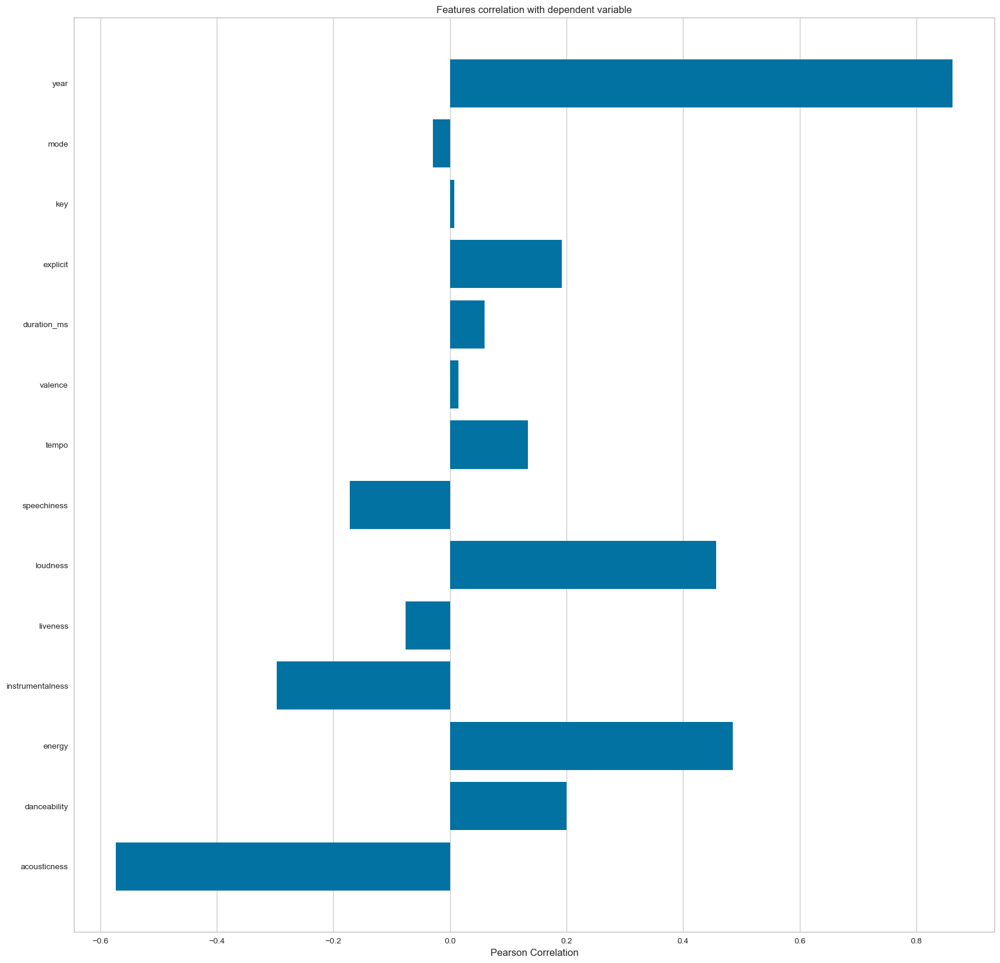

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [8]:
# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)

parameters = {'xtick.labelsize' : 45, 'ytick.labelsize' : 40}
plt.rcParams.update(parameters)
visualizer.show()

In [9]:
import seaborn as sns  # python 시각화 도구

<Axes: xlabel='decade', ylabel='count'>

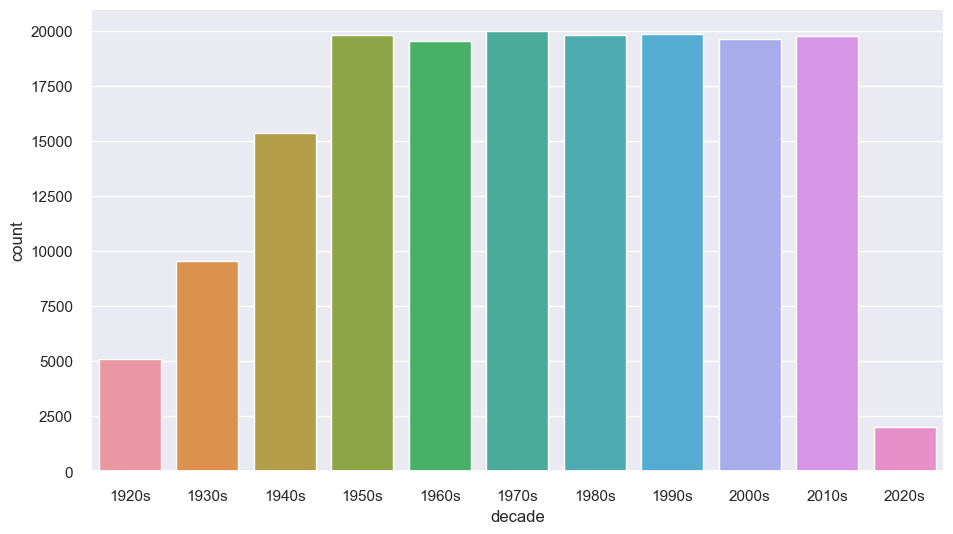

In [10]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(x=data['decade'])

In [11]:
import plotly.express as px # 선 그래프 표현할 때 사용

In [12]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

In [13]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# Clustering Genres with K-Means

In [14]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

In [24]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
print(X)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)
print(genre_data['cluster'])

      mode  acousticness  danceability   duration_ms    energy  \
0        1      0.979333      0.162883  1.602977e+05  0.071317   
1        1      0.494780      0.299333  1.048887e+06  0.450678   
2        1      0.762000      0.712000  1.151770e+05  0.818000   
3        1      0.651417      0.529093  2.328809e+05  0.419146   
4        1      0.676557      0.538961  1.906285e+05  0.316434   
...    ...           ...           ...           ...       ...   
2968     1      0.222625      0.547082  2.580991e+05  0.610240   
2969     0      0.161000      0.863000  2.063200e+05  0.909000   
2970     1      0.263261      0.748889  3.060728e+05  0.622444   
2971     0      0.993000      0.705667  1.984173e+05  0.172667   
2972     1      0.421038      0.629409  1.716717e+05  0.609369   

      instrumentalness  liveness   loudness  speechiness       tempo  \
0             0.606834  0.361600 -31.514333     0.040567   75.336500   
1             0.477762  0.131000 -16.854000     0.076817  120.2

C:\Users\USER\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



0       5
1       9
2       4
3       7
4       1
       ..
2968    4
2969    2
2970    4
2971    7
2972    4
Name: cluster, Length: 2973, dtype: int32


In [25]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
print(genre_embedding)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
print(projection['genres'])
projection['cluster'] = genre_data['cluster']
print(projection)

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.013s...
[t-SNE] Computed neighbors for 2973 samples in 0.323s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.807199
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.113396
[t-SNE] KL divergence after 1000 iterations: 1.185119
[[ 57.33809     4.8392625]
 [ 34.789177    2.6208112]
 [-12.9040365 -19.393887 ]
 ...
 [-46.201683  -12.332671 ]
 [ 40.152676  -28.336042 ]
 [-32.083054  -22.456383 ]]
0       21st century classical
1                        432hz
2                        8-bit
3                           []
4                   a cappella
                 ...          
2968                      zolo
2969                   zouglou
2970                      zouk
2971              zurich indie
2972                  

# Clustering Songs with K-Means

In [32]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False, n_init=10))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
print(number_cols)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
print(song_cluster_labels)
data['cluster_label'] = song_cluster_labels
print(data.head())

['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo', 'cluster_label']
[10  1 10 ...  0  5  5]
   valence  year  acousticness  \
0   0.0594  1921         0.982   
1   0.9630  1921         0.732   
2   0.0394  1921         0.961   
3   0.1650  1921         0.967   
4   0.2530  1921         0.957   

                                             artists  danceability  \
0  ['Sergei Rachmaninoff', 'James Levine', 'Berli...         0.279   
1                                     ['Dennis Day']         0.819   
2  ['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...         0.328   
3                                   ['Frank Parker']         0.275   
4                                     ['Phil Regan']         0.418   

   duration_ms  energy  explicit                      id  instrumentalness  \
0       831667   0.211         0  4BJqT0PrAfrxzMOxytFOIz          0.8

In [18]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()